In [1]:
import os
import sys
import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
from torch.autograd import Variable
import numpy as np
import cv2
if torch.cuda.is_available():
    torch.set_default_tensor_type('torch.cuda.FloatTensor')
 
from ssd import build_ssd
from data import VOC_CLASSES as labels

In [2]:
# SSDネットワークの定義と重みファイルのロード
net = build_ssd('test', 300, 4)    
net.load_weights('./weights/BCCD.pth')

Loading weights into state dict...
Finished!


In [3]:
from matplotlib import pyplot as plt
from data import VOCDetection, VOC_ROOT, VOCAnnotationTransform

In [4]:
testset = VOCDetection(VOC_ROOT, [('BCCD', 'test')], None, VOCAnnotationTransform())

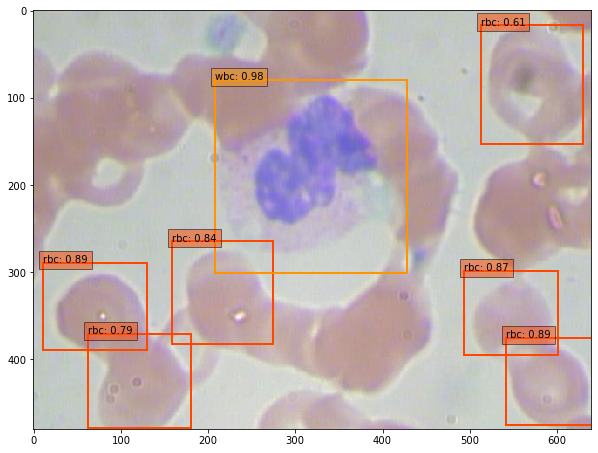

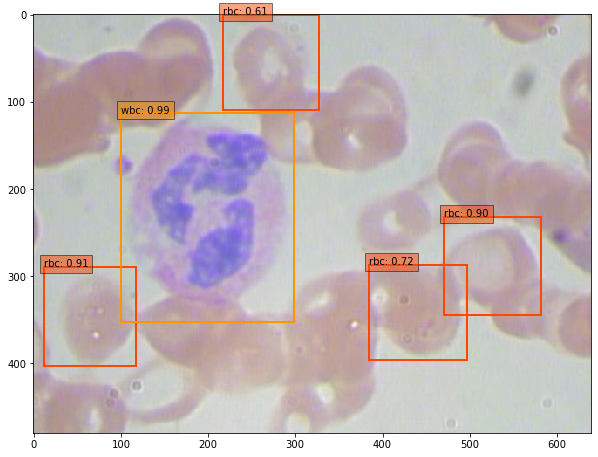

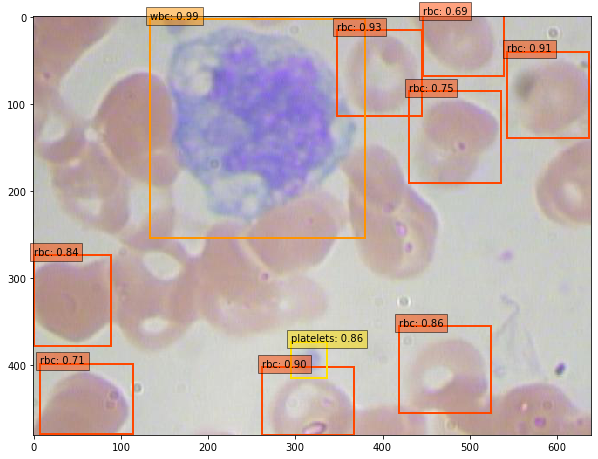

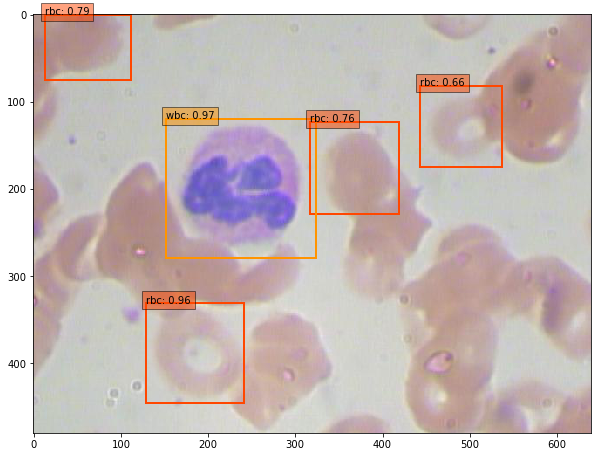

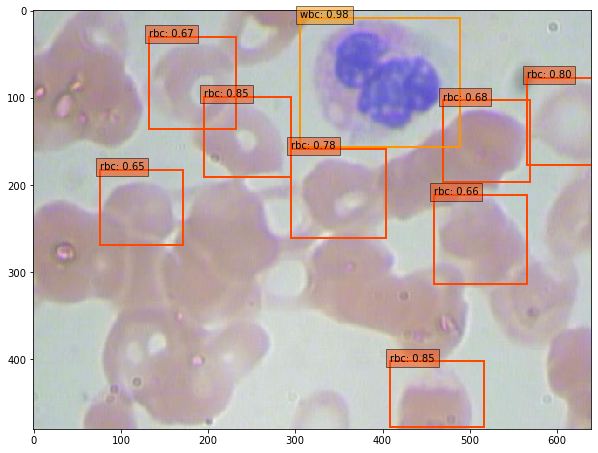

...

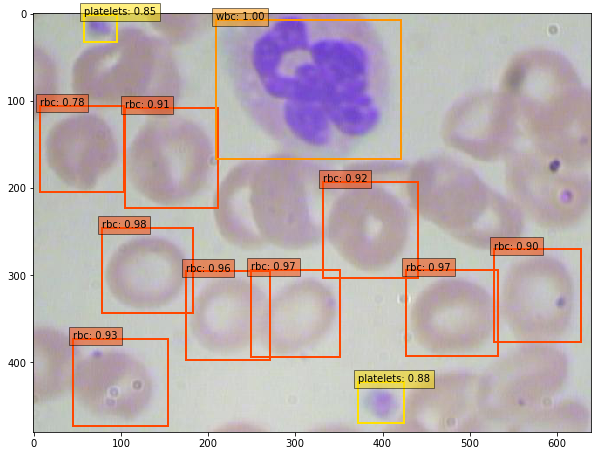

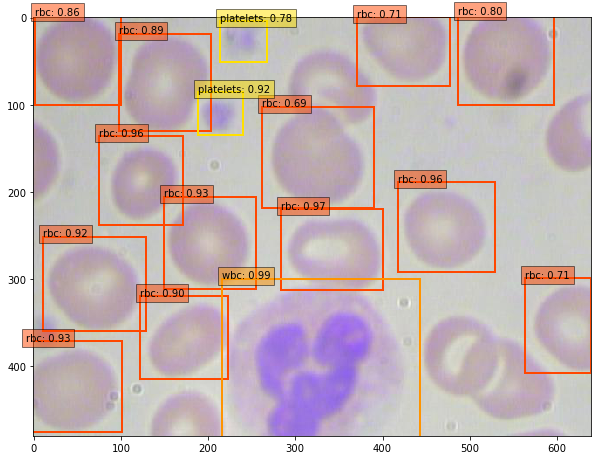

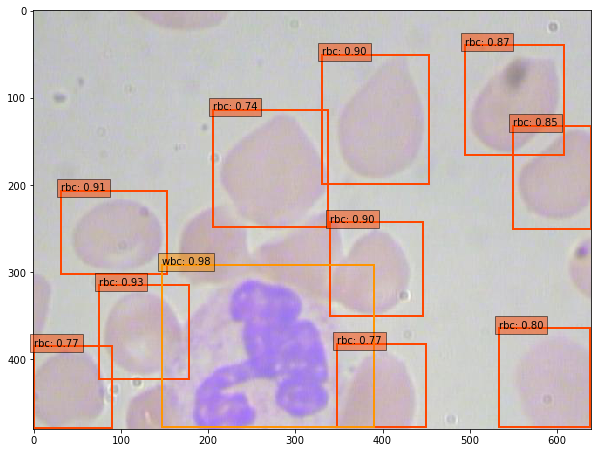

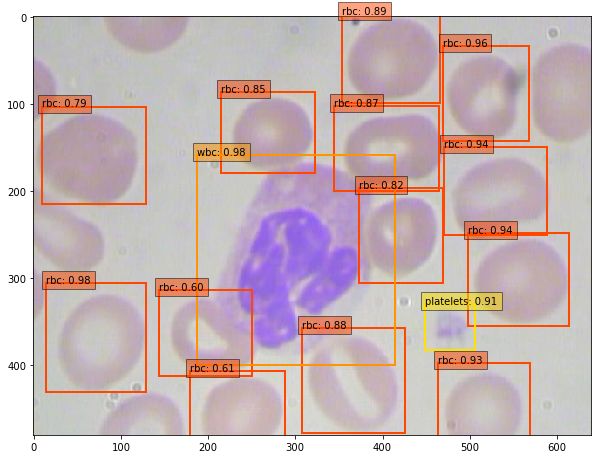

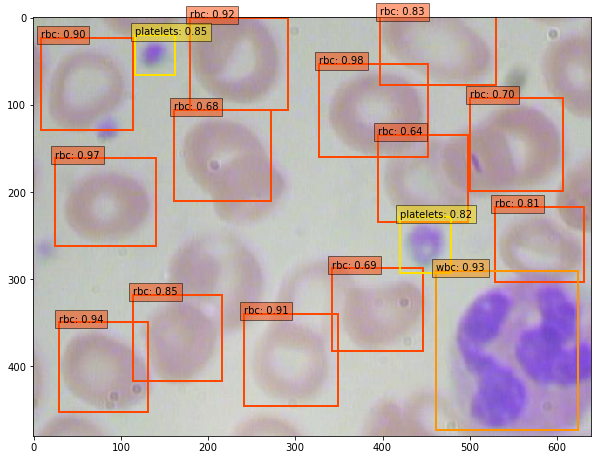

In [5]:
for i in range(len(testset)):
  num  = i
  image = testset.pull_image(i)
  x = cv2.resize(image, (300, 300)).astype(np.float32)  # 300*300にリサイズ
  x -= (104.0, 117.0, 123.0)
  x = x.astype(np.float32)
  x = x[:, :, ::-1].copy()
  x = torch.from_numpy(x).permute(2, 0, 1)  # [300,300,3] → [３,300,300]
  xx = Variable(x.unsqueeze(0))     # [3,300,300] → [1,3,300,300]
  if torch.cuda.is_available():
      xx = xx.cuda()
  # 順伝播を実行し、推論結果を出力    
  y = net(xx)
  rgb_image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
  plt.figure(figsize=(10,10))
  colors = plt.cm.hsv(np.linspace(0, 1, 21)).tolist()
  plt.imshow(rgb_image) 
  currentAxis = plt.gca()
  # 推論結果をdetectionsに格納
  detections = y.data
  # scale each detection back up to the image
  scale = torch.Tensor(rgb_image.shape[1::-1]).repeat(2)
  
  # バウンディングボックスとクラス名の表示
  for i in range(detections.size(1)):
      j = 0
      # 確信度confが0.6以上のボックスを表示
      # jは確信度上位200件のボックスのインデックス
      # detections[0,i,j]は[conf,xmin,ymin,xmax,ymax]の形状
      while detections[0,i,j,0] >= 0.6:
          score = detections[0,i,j,0]
          label_name = labels[i-1]
          display_txt = '%s: %.2f'%(label_name, score)
          pt = (detections[0,i,j,1:]*scale).cpu().numpy()
          coords = (pt[0], pt[1]), pt[2]-pt[0]+1, pt[3]-pt[1]+1
          color = colors[i]
          currentAxis.add_patch(plt.Rectangle(*coords, fill=False, edgecolor=color, linewidth=2))
          currentAxis.text(pt[0], pt[1], display_txt, bbox={'facecolor':color, 'alpha':0.5})
          j+=1
  plt.savefig('result_images/result'+str(num)+".png")
  plt.show()
  plt.close()